# Mobile Price Prediction

![image](what-affects-stock-price-scaled.jpg)

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

**Content:** 

The price of a phone become a necessity in our daily lives and the price of that depends on its specifications. In this notebook, we will explore the factors that affect cell phone prices and predict new samples based on the best model.

**Description of features:**
    
1- battery_power: Total energy a battery can store in one time measured in (mAh)
    
2- blue: Has bluetooth or not
    
3- clock_speed: Speed at which microprocessor executes instructions
    
4- dual_sim: Has dual sim support or not
    
5- fc: Front camera (Megapixels)
    
6- four_g: Has 4G or not
    
7- int_memory: Internal memory in (Gigabytes) 
    
8- m_dep: Mobile depth in (Cm)

9- mobile_wt: Weight of mobile phone
    
10- pc: Primary camera (Megapixels)
    
11- px_height: Pixel resolution height
    
12- px_width: Pixel resolution width
    
13- ram: Random access memory in (Megabytes)
    
14- sc_h: Screen height of mobile in (Cm)
    
15- sc_w: Screen width of mobile in (Cm)

16- talk_time: Longest time that a single battery charge will last when you are constantly talking on the phone

17- three_g: Has 3G or not

18- touch_screen: Has touch screen or not

19- wifi: Has wifi or not

20- n_cores: Number of cores of processor

21- price_range: This is the Target variable with value of 0: (Low Cost), 1: (Medium Cost), 2: (High Cost), and 3: (Very High Cost)

    
**Objective:**   
    
The classification goal is to predict the price range of a mobile phone by building a model that takes into account various features provided in the dataset. We will be using supervised learning methods such as **Decision Trees (DTs)**, **Random Forest**, and **Support Vector Machine (SVM)** to determine the best model for this problem.

In [16]:
# Data
import pandas as pd
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Train Test Split
from sklearn.model_selection import train_test_split

# Algorithms
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# KFold
from sklearn.model_selection import RepeatedStratifiedKFold

# Validation
from sklearn.model_selection import cross_val_predict

# Scaling
from sklearn.preprocessing import StandardScaler

# Metrics
from sklearn import metrics
from sklearn.metrics import confusion_matrix, auc, roc_curve
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay
from sklearn.metrics import ConfusionMatrixDisplay, classification_report
from statistics import stdev

# Supress warnings
import warnings
warnings.filterwarnings('ignore')

In [4]:
train = pd.read_csv('E:\Machine Learning\IMT/train.csv')

In [5]:
test = pd.read_csv('E:\Machine Learning\IMT/test.csv')

In [7]:
# Preview the dataset (train)
df_train = pd.DataFrame(train)
df_train

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,794,1,0.5,1,0,1,2,0.8,106,6,...,1222,1890,668,13,4,19,1,1,0,0
1996,1965,1,2.6,1,0,0,39,0.2,187,4,...,915,1965,2032,11,10,16,1,1,1,2
1997,1911,0,0.9,1,1,1,36,0.7,108,8,...,868,1632,3057,9,1,5,1,1,0,3
1998,1512,0,0.9,0,4,1,46,0.1,145,5,...,336,670,869,18,10,19,1,1,1,0


In [8]:
# Preview the dataset (test)
df_test = pd.DataFrame(test)
df_test

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,...,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,...,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,...,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,...,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,...,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,...,18,749,810,1773,15,8,7,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,996,1700,1,1.9,0,0,1,54,0.5,170,...,17,644,913,2121,14,8,15,1,1,0
996,997,609,0,1.8,1,0,0,13,0.9,186,...,2,1152,1632,1933,8,1,19,0,1,1
997,998,1185,0,1.4,0,1,1,8,0.5,80,...,12,477,825,1223,5,0,14,1,0,0
998,999,1533,1,0.5,1,0,0,50,0.4,171,...,12,38,832,2509,15,11,6,0,1,0


In [9]:
df_train.describe()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
count,2000.000000,2000.0000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,...,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,0.4950,1.522250,0.509500,4.309500,0.521500,32.046500,0.501750,140.249000,4.520500,...,645.108000,1251.515500,2124.213000,12.306500,5.767000,11.011000,0.761500,0.503000,0.507000,1.500000
std,439.418206,0.5001,0.816004,0.500035,4.341444,0.499662,18.145715,0.288416,35.399655,2.287837,...,443.780811,432.199447,1084.732044,4.213245,4.356398,5.463955,0.426273,0.500116,0.500076,1.118314
min,501.000000,0.0000,0.500000,0.000000,0.000000,0.000000,2.000000,0.100000,80.000000,1.000000,...,0.000000,500.000000,256.000000,5.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000
25%,851.750000,0.0000,0.700000,0.000000,1.000000,0.000000,16.000000,0.200000,109.000000,3.000000,...,282.750000,874.750000,1207.500000,9.000000,2.000000,6.000000,1.000000,0.000000,0.000000,0.750000
50%,1226.000000,0.0000,1.500000,1.000000,3.000000,1.000000,32.000000,0.500000,141.000000,4.000000,...,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000,1.000000,1.000000,1.000000,1.500000
75%,1615.250000,1.0000,2.200000,1.000000,7.000000,1.000000,48.000000,0.800000,170.000000,7.000000,...,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000,1.000000,1.000000,1.000000,2.250000
max,1998.000000,1.0000,3.000000,1.000000,19.000000,1.000000,64.000000,1.000000,200.000000,8.000000,...,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000,1.000000,1.000000,1.000000,3.000000


In [10]:
def check(df):
    l=[]
    columns=df.columns
    for col in columns:
        dtypes=df[col].dtypes
        nunique=df[col].nunique()
        sum_null=df[col].isnull().sum()
        l.append([col,dtypes,nunique,sum_null])
    df_check=pd.DataFrame(l)
    df_check.columns=['column','dtypes','nunique','sum_null']
    return df_check 

In [11]:
check(df_train)

,column,dtypes,nunique,sum_null
0,battery_power,int64,1094,0
1,blue,int64,2,0
2,clock_speed,float64,26,0
3,dual_sim,int64,2,0
4,fc,int64,20,0
5,four_g,int64,2,0
6,int_memory,int64,63,0
7,m_dep,float64,10,0
8,mobile_wt,int64,121,0
9,n_cores,int64,8,0


In [12]:
check(df_test)

,column,dtypes,nunique,sum_null
0,id,int64,1000,0
1,battery_power,int64,721,0
2,blue,int64,2,0
3,clock_speed,float64,26,0
4,dual_sim,int64,2,0
5,fc,int64,20,0
6,four_g,int64,2,0
7,int_memory,int64,63,0
8,m_dep,float64,10,0
9,mobile_wt,int64,121,0


In [14]:
# Separate numerical and categorical features
num_cols = pd.DataFrame (df_train, columns= ['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time'])
cat_cols = pd.DataFrame (df_train, columns= ['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi'])

In [17]:
for col in cat_cols:
    fig2 = px.histogram(df,x=col,color=col)
    fig2.show()

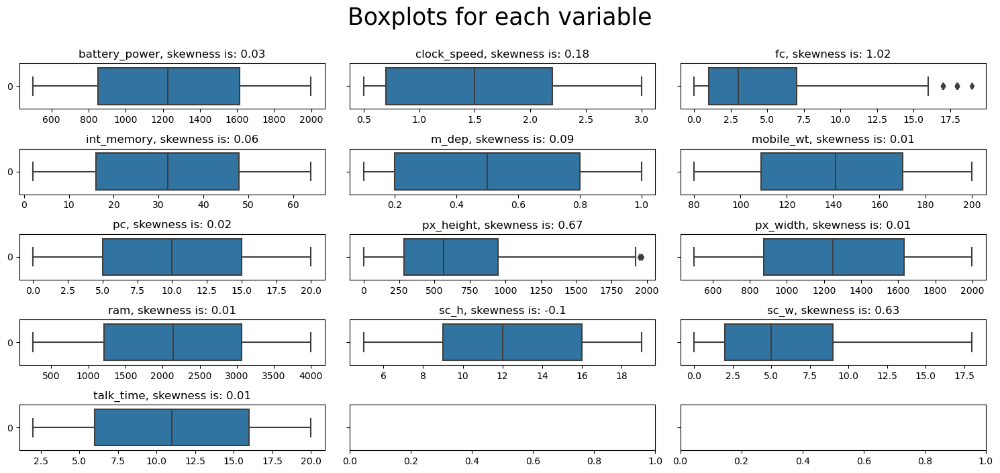

In [19]:
# Visualizing the Numerical Features by boxplots
def boxplots_custom(dataset, columns_list, rows, cols, suptitle):
    fig, axs = plt.subplots(rows, cols, sharey=True, figsize=(15,7))
    fig.suptitle(suptitle,y=1, size=25)
    axs = axs.flatten()
    for i, data in enumerate(columns_list):
        sns.boxplot(data=dataset[data], orient='h', ax=axs[i])
        axs[i].set_title(data + ', skewness is: '+str(round(dataset[data].skew(axis = 0, skipna = True), 2)))
        
boxplots_custom(dataset=df_train, columns_list=num_cols, rows=5, cols=3, suptitle='Boxplots for each variable')
plt.tight_layout()

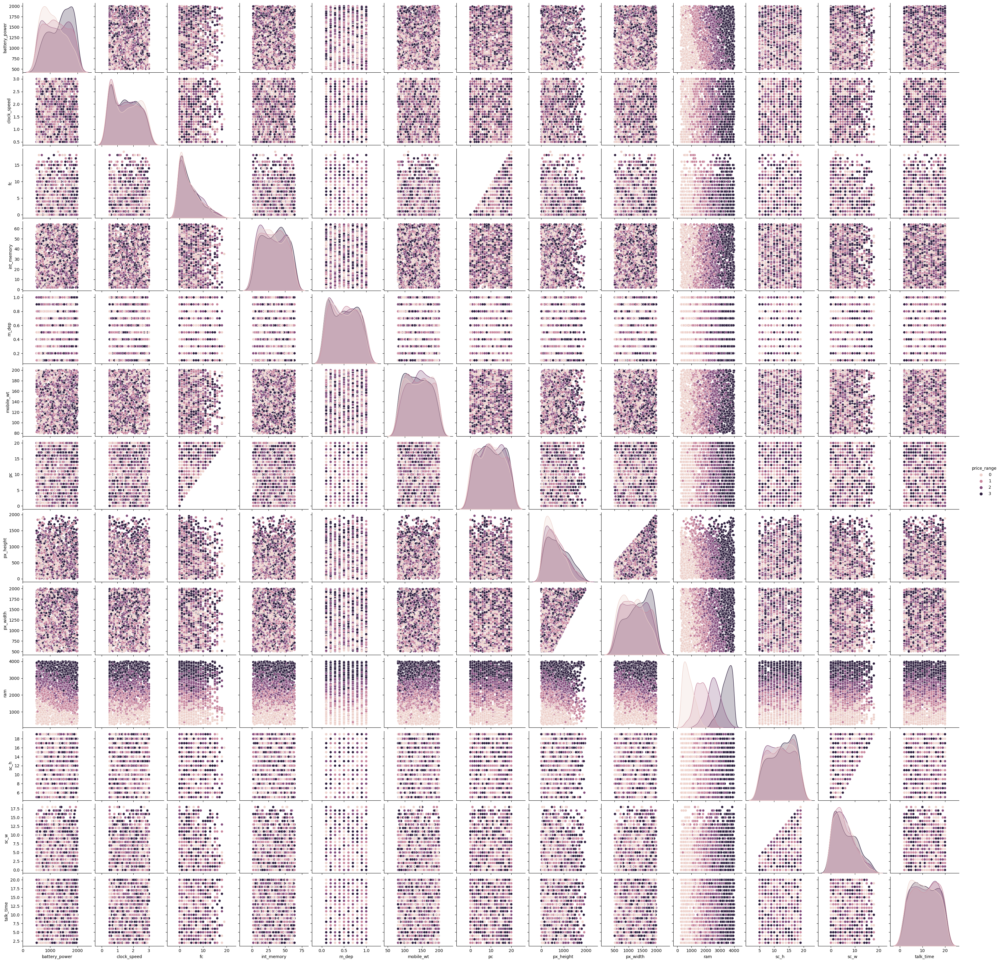

In [24]:
sns.pairplot(data=df_train[['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'pc', 'px_height',
                            'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time', 'price_range']], 
             hue='price_range');

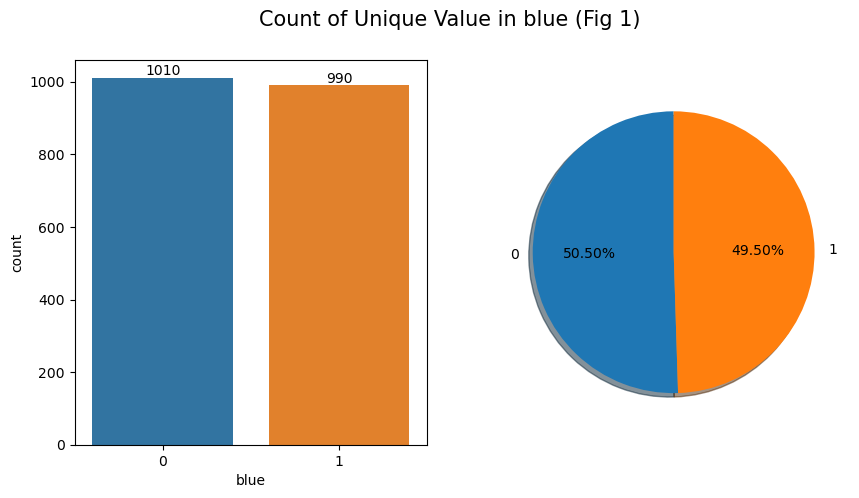

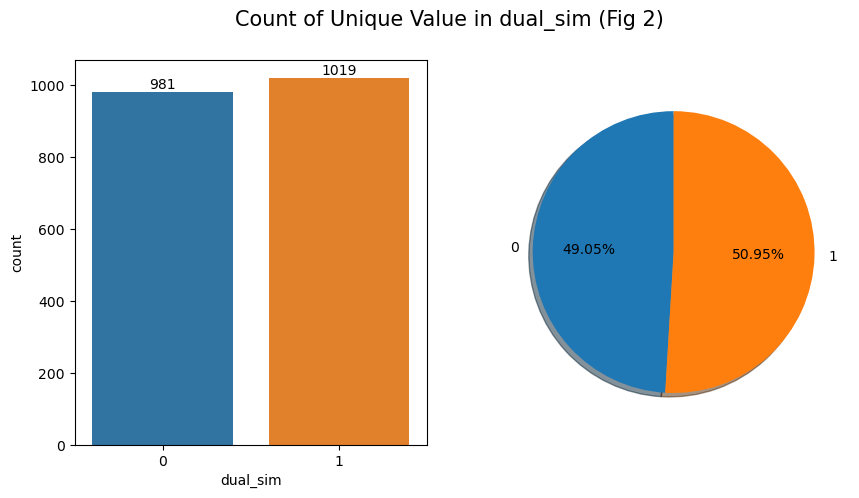

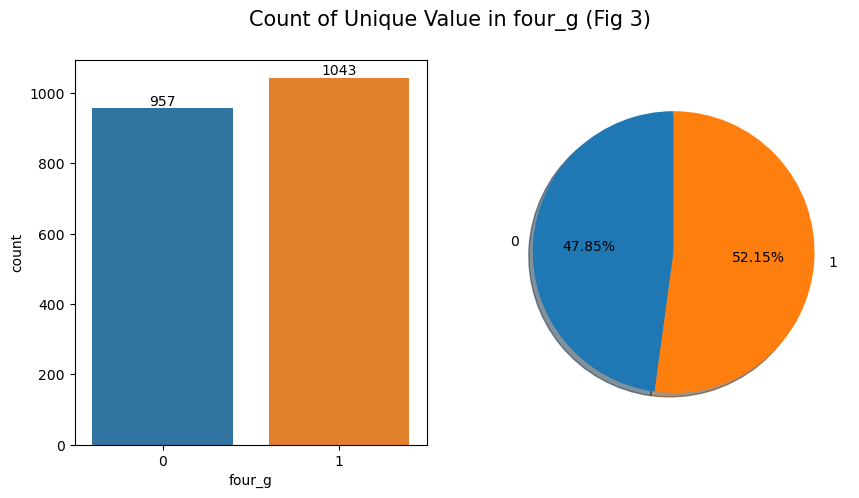

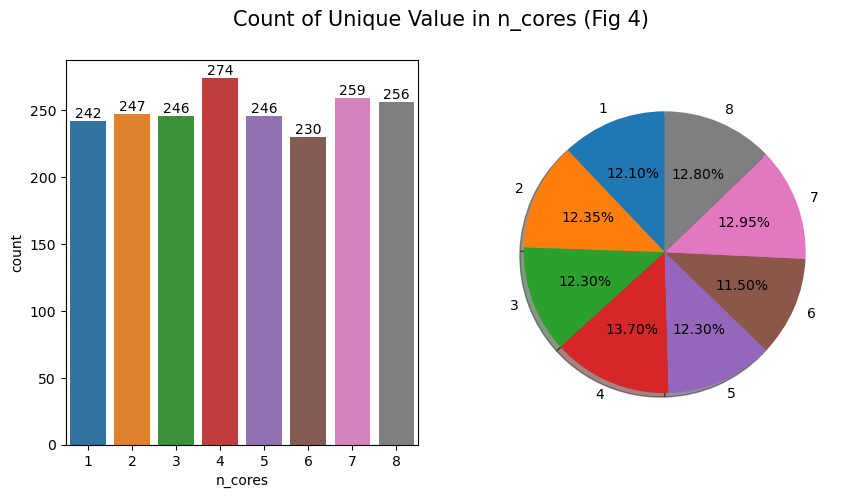

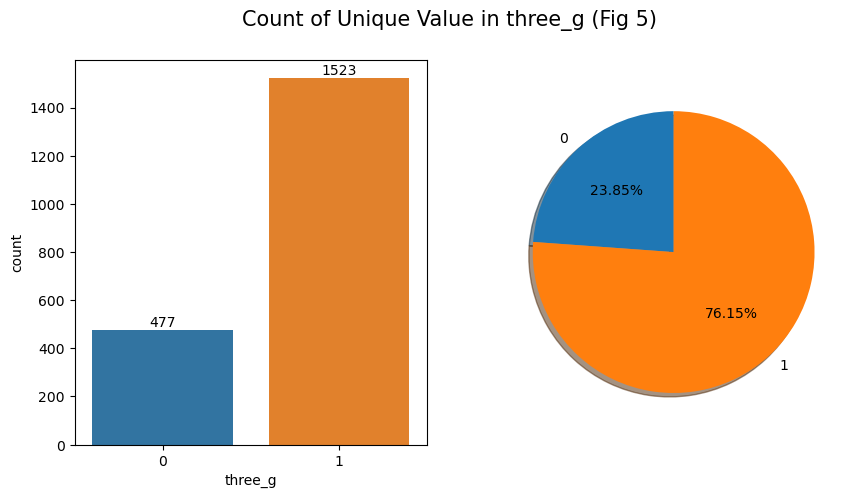

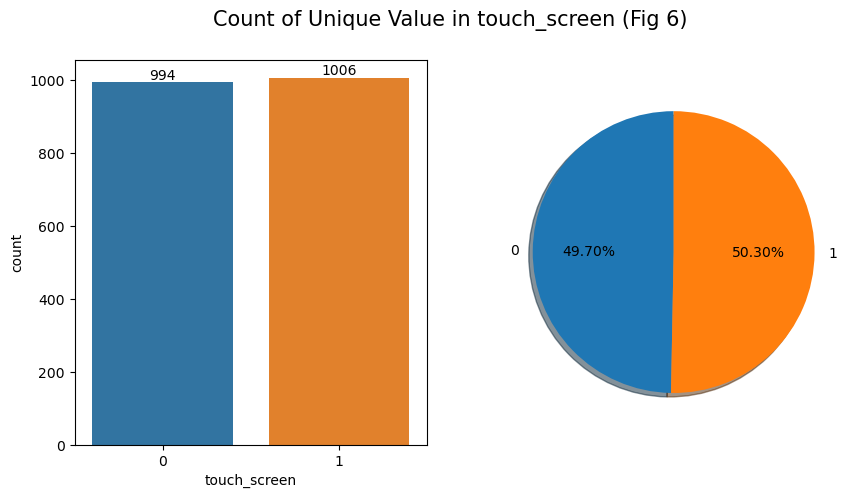

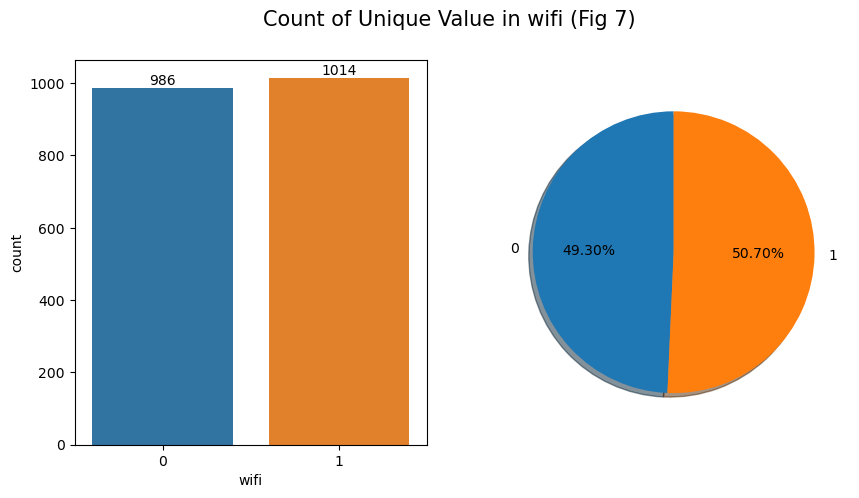

In [25]:
for i, col in enumerate(cat_cols):

    fig, axes = plt.subplots(1,2,figsize=(10,5))
# palette = 'hls'
    # count of col (countplot)
    sns.countplot(data=df_train, x=col, ax=axes[0] )
    for container in axes[0].containers:
        axes[0].bar_label(container)
    # count of col (pie chart)
    slices = df_train[col].value_counts().sort_index().values
    activities = [var for var in df_train[col].value_counts().sort_index().index]
    axes[1].pie(slices, labels=activities, shadow=True, autopct='%1.2f%%' ,startangle=90 )
    
    
 
    plt.suptitle(f'Count of Unique Value in {col} (Fig {i+1})',fontsize=15)
    plt.show()

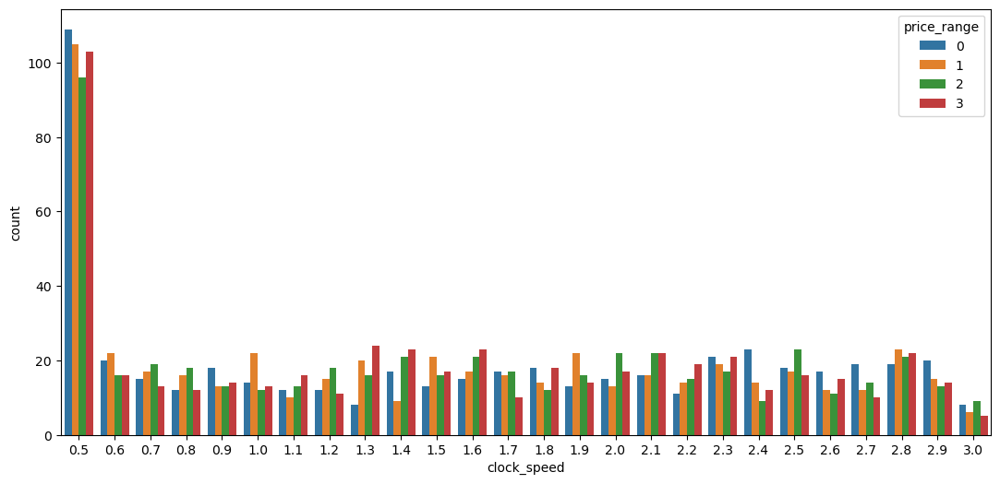

In [26]:
plt.figure(figsize = (13,6))
sns.countplot(x = df_train['clock_speed'], hue ="price_range", data=df_train) 
plt.show()

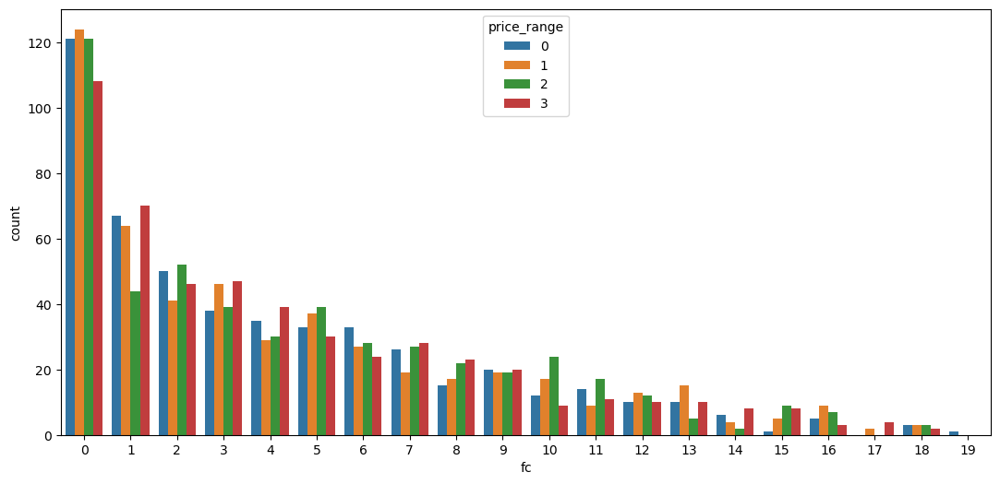

In [27]:
# fc based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = df_train['fc'], hue ="price_range", data=df_train) 
plt.show()

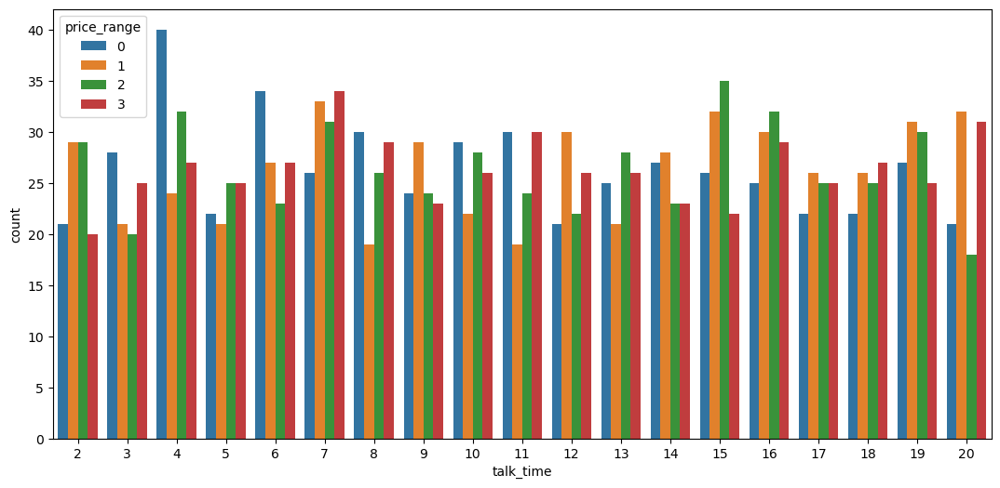

In [28]:
# talk_time based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = df_train['talk_time'], hue ="price_range", data=df_train) 
plt.show()

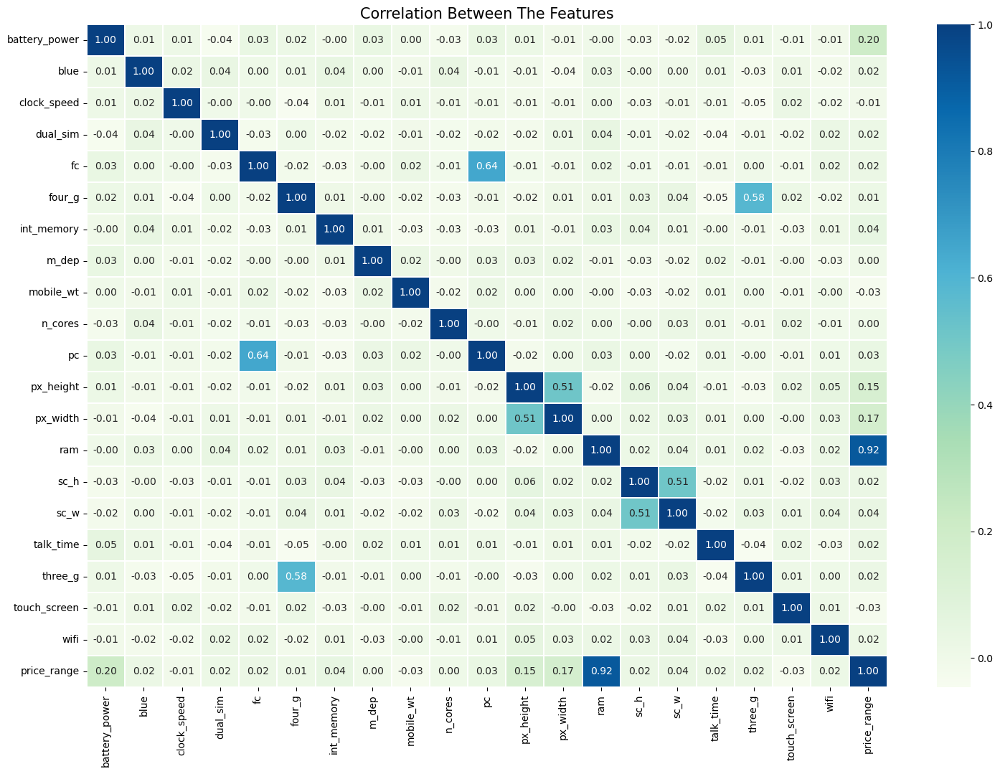

In [29]:
fig=plt.gcf()
fig.set_size_inches(18, 12)
plt.title('Correlation Between The Features', size=15)
a = sns.heatmap(df_train.corr(), annot = True, cmap = 'GnBu', fmt='.2f', linewidths=0.2)
plt.show()

<a class="anchor" id="About_Data"></a>
# <p style="padding:10px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">Model Building</p> 

### Decision Tree

In [30]:
df = df_train
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [31]:
# Check the shape of X and y
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


In [33]:
# Array of test size value from 0.2 to 0.35
test_size = np.arange(start=0.2, stop=0.35, step= 0.05)

# Initialize a list where we'll store the score of each test size
score =[]
for size in test_size:
    X_train1, X_test1, y_train1, y_test1 = train_test_split (X, y, test_size=size, random_state=0)
    DT_Clf = DecisionTreeClassifier (max_depth=3)
    DT_Clf.fit (X_train1, y_train1)
    score.append (DT_Clf.score (X_test1, y_test1))

# Create a dataframe to display the results 
r= pd.DataFrame({'Test size': test_size , 'Score': score})
r.sort_values(by = ['Score'], ascending = False, inplace = True)
r

,Test size,Score
1,0.25,0.764000
0,0.20,0.757500
2,0.30,0.748333


In [34]:
# Split X and y into training and testing sets
X_train1, X_test1, y_train1, y_test1 = train_test_split (X, y, stratify=y, test_size = 0.25, random_state = 0)

In [35]:
# check the shape of X_train, X_test, y_train and y_test
print('X_train shape: ', X_train1.shape)
print('X_test shape: ', X_test1.shape)
print('y_train shape: ', y_train1.shape)
print('y_test shape: ', y_test1.shape)

X_train shape:  (1500, 20)
X_test shape:  (500, 20)
y_train shape:  (1500, 1)
y_test shape:  (500, 1)


In [36]:
# Scale the features using StandardScaler
scaler = StandardScaler()

# Fit the scaler to the training data and transform it
X_train1 = scaler.fit_transform(X_train1)

# Transform the test data using the same scaler
X_test1 = scaler.transform(X_test1)

In [37]:
# Instantiate the model
DT_model = DecisionTreeClassifier(max_depth=3)

# Fit the model to the training set
DT_model.fit(X_train1, y_train1)

DecisionTreeClassifier(max_depth=3)

In [38]:
y_pred = DT_model.predict(X_test1)

In [39]:
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test1, y_pred)))

Model accuracy score: 0.7520


In [40]:
# print the scores on training and test set
print('Training set score: {:.4f}'.format(DT_model.score(X_train1, y_train1)))
print('Test set score: {:.4f}'.format(DT_model.score(X_test1, y_test1)))

Training set score: 0.7693
Test set score: 0.7520


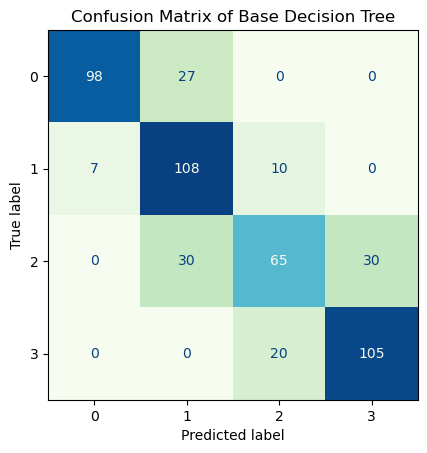

In [41]:
ConfusionMatrixDisplay.from_estimator(DT_model, X_test1, y_test1, colorbar=False, cmap='GnBu')
plt.title('Confusion Matrix of Base Decision Tree')
plt.grid(False)

In [42]:
print(classification_report(y_test1, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.78      0.85       125
           1       0.65      0.86      0.74       125
           2       0.68      0.52      0.59       125
           3       0.78      0.84      0.81       125

    accuracy                           0.75       500
   macro avg       0.76      0.75      0.75       500
weighted avg       0.76      0.75      0.75       500



In [43]:
def metrics_calculator(y_test, y_pred, model_name):
    '''
    This function calculates all desired performance metrics for a given model.
    '''
    result = pd.DataFrame(data=[accuracy_score(y_test, y_pred),
                                precision_score(y_test, y_pred, average='macro'),
                                recall_score(y_test, y_pred, average='macro'),
                                f1_score(y_test, y_pred, average='macro')],
                          index=['Accuracy','Precision','Recall','F1-score'],
                          columns = [model_name])
    return result

In [44]:
BaseDT_result = metrics_calculator(y_test1, y_pred, 'Base Decision Tree')
BaseDT_result

,Base Decision Tree
Accuracy,0.752000
Precision,0.762467
Recall,0.752000
F1-score,0.748901


In [45]:
from sklearn.preprocessing import label_binarize

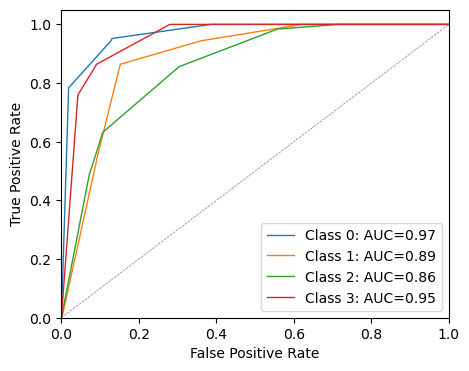

In [46]:
y_Pred_prob = DT_model.predict_proba(X_test1)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test1, y_Pred_prob)

In [47]:
from sklearn import tree

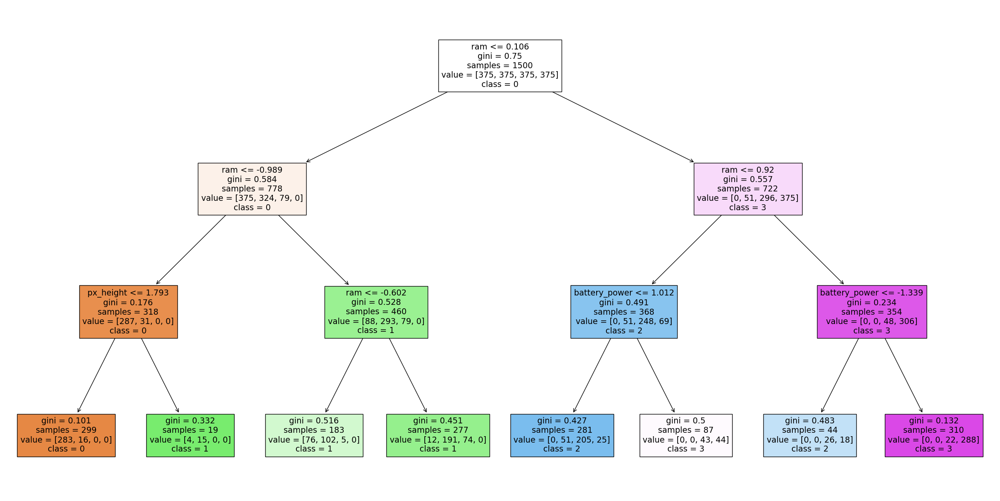

In [48]:
feature_names = X.columns
target_names = ["0", "1", "2", "3"]

fig = plt.figure(figsize = (30, 15))
Plot = tree.plot_tree (DT_model, feature_names = feature_names, class_names = target_names, filled = True)

### Random Forest

In [49]:
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [50]:
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


In [51]:
# Array of test size value from 0.2 to 0.35
test_size = np.arange(start=0.2, stop=0.35, step=0.05)

# Initialize a list where we'll store the score of each test size
score = []
for size in test_size:
    X_train2, X_test2, y_train2, y_test2 = train_test_split (X, y, test_size=size, random_state=0)
    RF_model = RandomForestClassifier ()
    RF_model.fit (X_train2, y_train2)
    score.append (RF_model.score (X_test2, y_test2))
    
# Create a dataframe to display the results   
r= pd.DataFrame({'Test size': test_size, 'Score': score})
r.sort_values(by = ['Score'], ascending = False, inplace = True)
r

,Test size,Score
1,0.25,0.868000
0,0.20,0.865000
2,0.30,0.863333


In [62]:
# Split X and y into training and testing sets
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, stratify=y, test_size = 0.25, random_state = 0)

In [63]:
# check the shape of X_train, X_test, y_train and y_test
print('X_train shape:', X_train2.shape)
print('X_test shape:', X_test2.shape)
print('y_train shape:', y_train2.shape)
print('y_test shape:', y_test2.shape)

X_train shape: (1500, 20)
X_test shape: (500, 20)
y_train shape: (1500, 1)
y_test shape: (500, 1)


In [64]:
# Scale the features using StandardScaler
scaler = StandardScaler()

# Fit the scaler to the training data and transform it
X_train2 = scaler.fit_transform(X_train2)

# Transform the test data using the same scaler
X_test2 = scaler.transform(X_test2)

In [65]:
# Instantiate the model
RF_model = RandomForestClassifier()

# Fit the model to the training set
RF_model.fit(X_train2, y_train2)

RandomForestClassifier()

In [66]:
y_pred = RF_model.predict(X_test2)

In [67]:
print('Model Accuracy Score: {0:0.4f}'. format(accuracy_score(y_test2, y_pred)))

Model Accuracy Score: 0.8820


In [68]:
# Scores on training and test set
print('Training set score: {:.4f}'.format(RF_model.score(X_train2, y_train2)))
print('Test set score: {:.4f}'.format(RF_model.score(X_test2, y_test2)))

Training set score: 1.0000
Test set score: 0.8820


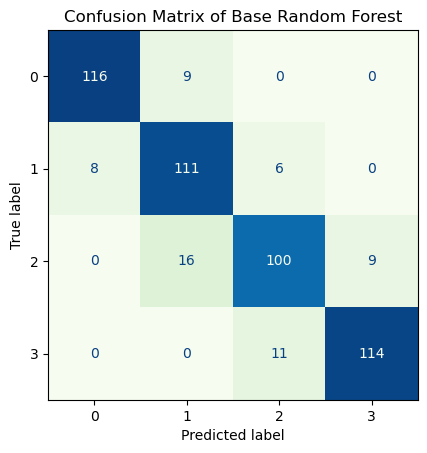

In [69]:
ConfusionMatrixDisplay.from_estimator(RF_model, X_test2, y_test2, colorbar=False, cmap='GnBu')
plt.title('Confusion Matrix of Base Random Forest')
plt.grid(False)

In [70]:
print(classification_report(y_test2, y_pred))

              precision    recall  f1-score   support

           0       0.94      0.93      0.93       125
           1       0.82      0.89      0.85       125
           2       0.85      0.80      0.83       125
           3       0.93      0.91      0.92       125

    accuracy                           0.88       500
   macro avg       0.88      0.88      0.88       500
weighted avg       0.88      0.88      0.88       500



In [71]:
BaseRF_result = metrics_calculator(y_test2, y_pred, 'Base Random Forest')
BaseRF_result

,Base Random Forest
Accuracy,0.882000
Precision,0.883298
Recall,0.882000
F1-score,0.882026


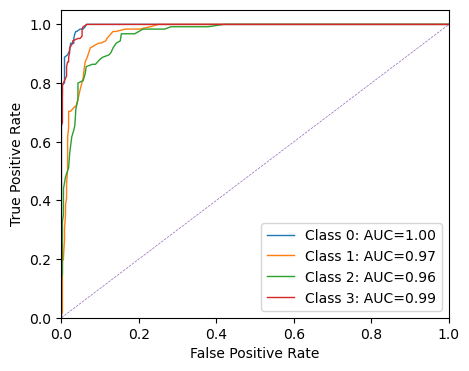

In [72]:
y_Pred_prob = RF_model.predict_proba(X_test2)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test2, y_Pred_prob)

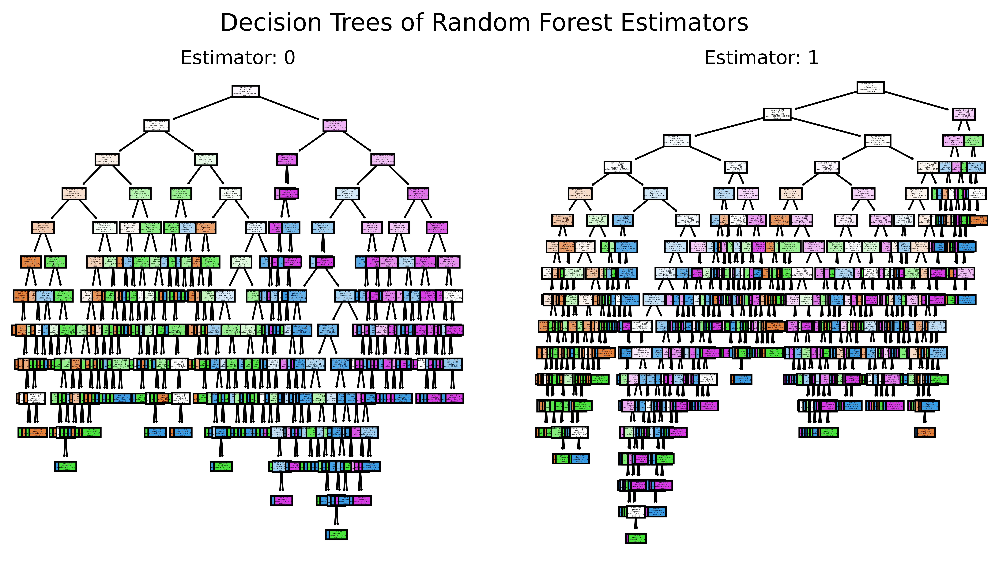

In [73]:
# Get the feature names and class names
fn = X.columns
cn = ["0", "1", "2", "3"]

# Create a figure with two subplots
fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize = (10,5), dpi=900)

# Loop over the two estimators and plot the decision trees
for index in range(0, 2): # for example (2 Estimators)
    tree.plot_tree(RF_model.estimators_[index], feature_names = fn, class_names=cn, filled = True, ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
    
# Add overall title to the figure
fig.suptitle("Decision Trees of Random Forest Estimators", fontsize=14)
plt.show()

### Support Vector Machine

In [74]:
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [75]:
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


In [77]:
# Array of test size value from 0.2 to 0.35
test_size = np.arange(start=0.2, stop=0.35, step=0.05)

# Initialize a list where we'll store the score of each test size
score = []
for size in test_size:
    X_train3, X_test3, y_train3, y_test3 = train_test_split (X, y, test_size=size, random_state=0)
    svm_model = SVC()
    svm_model.fit (X_train3, y_train3)
    score.append (svm_model.score (X_test3, y_test3))
    
# Create a dataframe to display the results   
r= pd.DataFrame({'Test size': test_size, 'Score': score})
r.sort_values(by = ['Score'], ascending = False, inplace = True)
r

,Test size,Score
0,0.20,0.955000
1,0.25,0.954000
2,0.30,0.948333


In [78]:
# Split X and y into training and testing sets
X_train3, X_test3, y_train3, y_test3 = train_test_split (X, y, stratify=y, test_size = 0.2 , random_state = 0)

In [79]:
# check the shape of X_train, X_test, y_train and y_test
print('X_train shape:', X_train3.shape)
print('X_test shape:', X_test3.shape)
print('y_train shape:', y_train3.shape)
print('y_test shape:', y_test3.shape)

X_train shape: (1600, 20)
X_test shape: (400, 20)
y_train shape: (1600, 1)
y_test shape: (400, 1)


In [80]:
# Scale the features using StandardScaler
scaler = StandardScaler()

# Fit the scaler to the training data and transform it
X_train3 = scaler.fit_transform(X_train3)

# Transform the test data using the same scaler
X_test3 = scaler.transform(X_test3)

In [81]:
# Instantiate the model
svm_model = SVC(probability=True)

# Fit the model to the training set
svm_model.fit(X_train3, y_train3)

SVC(probability=True)

In [82]:
y_pred = svm_model.predict(X_test3)

In [83]:
print('Model Accuracy Score: {0:0.4f}'. format(accuracy_score(y_test3, y_pred)))

Model Accuracy Score: 0.8925


In [84]:
# Scores on training and test set
print('Training set score: {:.4f}'.format(svm_model.score(X_train3, y_train3)))
print('Test set score: {:.4f}'.format(svm_model.score(X_test3, y_test3)))

Training set score: 0.9812
Test set score: 0.8925


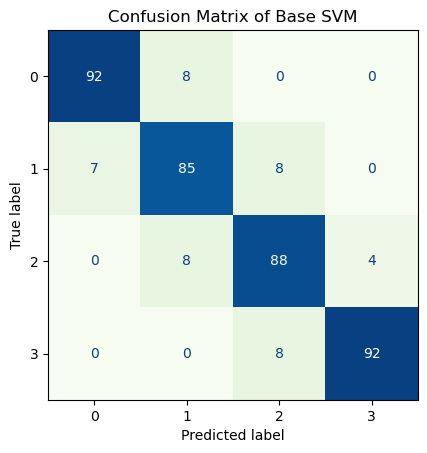

In [85]:
ConfusionMatrixDisplay.from_estimator(svm_model, X_test3, y_test3, colorbar=False, cmap='GnBu')
plt.title('Confusion Matrix of Base SVM')
plt.grid(False)

In [86]:
print(classification_report(y_test3, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.92      0.92       100
           1       0.84      0.85      0.85       100
           2       0.85      0.88      0.86       100
           3       0.96      0.92      0.94       100

    accuracy                           0.89       400
   macro avg       0.89      0.89      0.89       400
weighted avg       0.89      0.89      0.89       400



In [87]:
BaseSVM_result = metrics_calculator(y_test3, y_pred, 'Base SVM')
BaseSVM_result

,Base SVM
Accuracy,0.892500
Precision,0.893841
Recall,0.892500
F1-score,0.892979


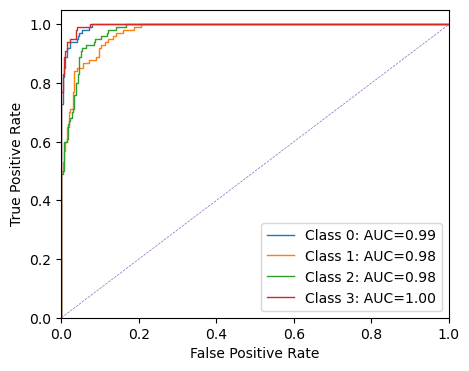

In [88]:
y_Pred_prob = svm_model.predict_proba(X_test3)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test3, y_Pred_prob)

<a class="anchor" id="About_Data"></a>
# <p style="padding:10px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">Conclusion</p> 

In [90]:
Conclusion = pd.concat([BaseDT_result ,BaseRF_result, BaseSVM_result], axis=1)
Conclusion

,Base Decision Tree,Base Random Forest,Base SVM
Accuracy,0.752000,0.882000,0.892500
Precision,0.762467,0.883298,0.893841
Recall,0.752000,0.882000,0.892500
F1-score,0.748901,0.882026,0.892979
